In [1]:
import pandas as pd 
import numpy as np 
from sklearn.preprocessing import StandardScaler 
from sklearn.linear_model  import Ridge,Lasso,RidgeCV, LassoCV, ElasticNet, ElasticNetCV, LogisticRegression
from sklearn.model_selection import train_test_split
from statsmodels.stats.outliers_influence import variance_inflation_factor 
from sklearn.metrics import accuracy_score, confusion_matrix, roc_curve, roc_auc_score
import matplotlib.pyplot as plt
from pandas_profiling import ProfileReport
import seaborn as sns
import pickle

In [2]:
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/diabetes.csv")

In [3]:
df

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101,76,48,180,32.9,0.171,63,0
764,2,122,70,27,0,36.8,0.340,27,0
765,5,121,72,23,112,26.2,0.245,30,0
766,1,126,60,0,0,30.1,0.349,47,1


In [4]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [5]:
"""
Observations:
1. No multicolling
2. Data skew on right side
3. No missing values
4. Zero's are present in dataset
"""

"\nObservations:\n1. No multicolling\n2. Data skew on right side\n3. No missing values\n4. Zero's are present in dataset\n"

In [6]:
df[df['BMI'] == 0].count()

Pregnancies                 11
Glucose                     11
BloodPressure               11
SkinThickness               11
Insulin                     11
BMI                         11
DiabetesPedigreeFunction    11
Age                         11
Outcome                     11
dtype: int64

In [7]:
# To replace all the zeros with mean
# if data set are skew then always use mean to replace zero values.

In [8]:
df['BMI'] = df['BMI'].replace(0,df['BMI'].mean())

In [9]:
df.columns

Index(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome'],
      dtype='object')

In [10]:
df['BloodPressure'] = df['BloodPressure'].replace(0,df['BloodPressure'].mean())

In [11]:
df['Insulin'] = df['Insulin'].replace(0,df['Insulin'].mean())

In [12]:
df['Glucose'] = df['Glucose'].replace(0,df['Glucose'].mean())

In [13]:
df['SkinThickness'] = df['SkinThickness'].replace(0,df['SkinThickness'].mean())

In [14]:
df

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
4,0,137.0,40.0,35.000000,168.000000,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


In [15]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [17]:
# To find boxplot

In [18]:
fig, ax = plt.subplots(figsize =(10,20))
sns.boxplot(data = df, ax = ax)

<AxesSubplot:>

In [19]:
ax

<AxesSubplot:>

In [20]:
fig,  ax= plt.subplots(figsize = (20,20))
sns.boxplot(data = df, ax = ax)

<AxesSubplot:>

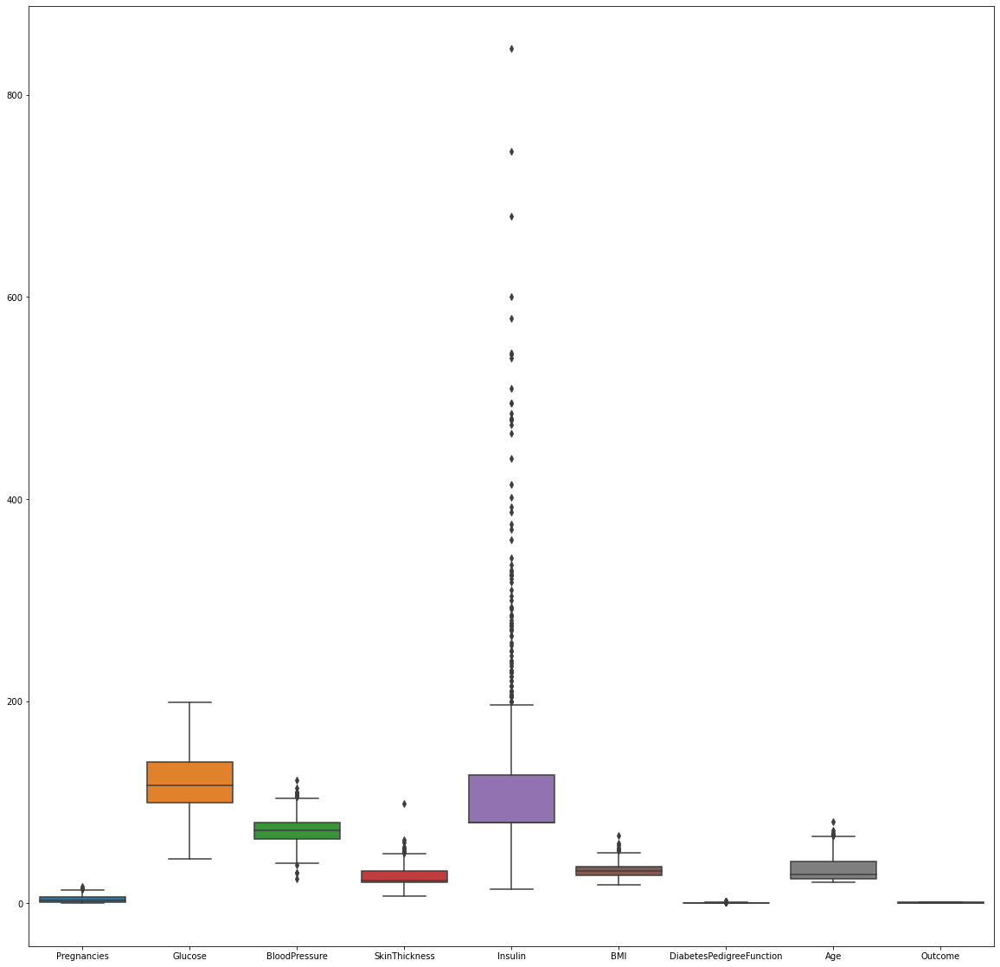

In [21]:
fig

In [22]:
q = df['Insulin'].quantile(.95) # when we use quantile, we will remove same data set, if you find df dataset having 768 data, and df_new=728
df_new = df[df['Insulin'] < q]

In [23]:
df_new

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
4,0,137.0,40.0,35.000000,168.000000,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


In [24]:
fig,  ax= plt.subplots(figsize = (20,20))
sns.boxplot(data = df_new, ax = ax)

<AxesSubplot:>

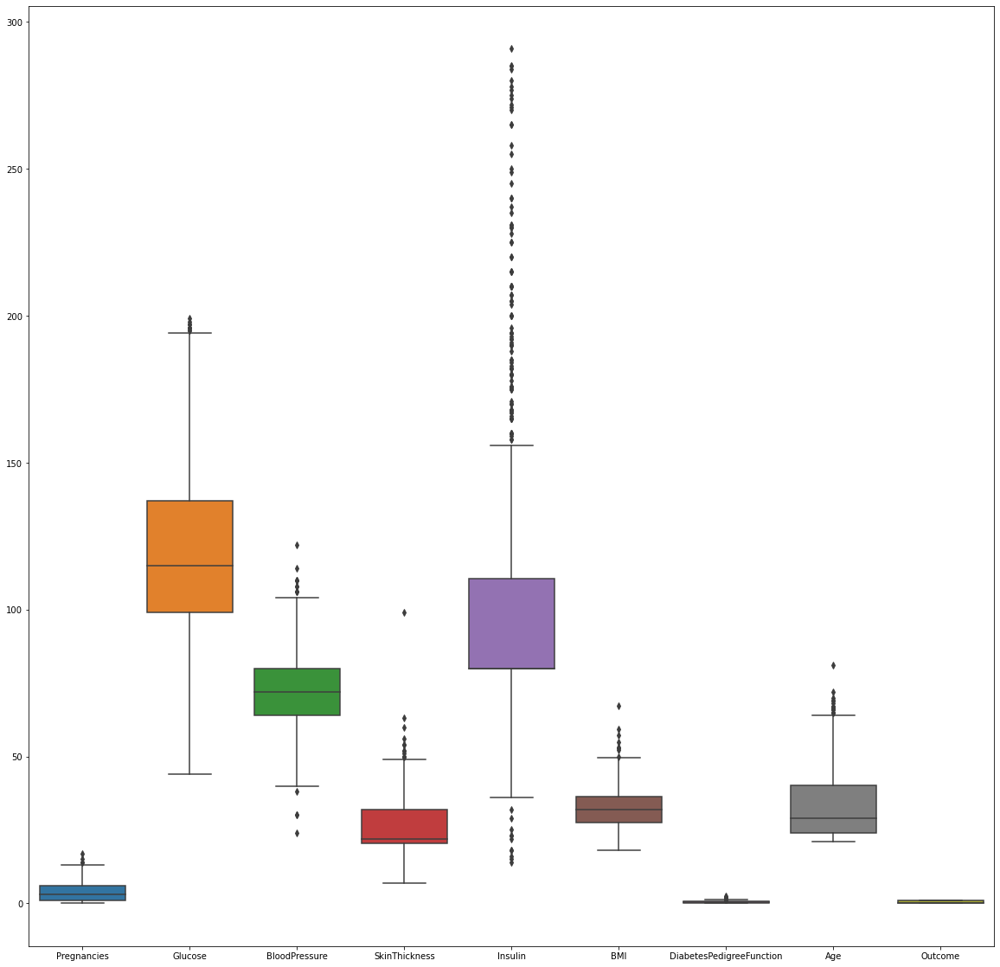

In [25]:
fig

In [26]:
q = df['Pregnancies'].quantile(.98)
df_new = df[df['Pregnancies'] < q]

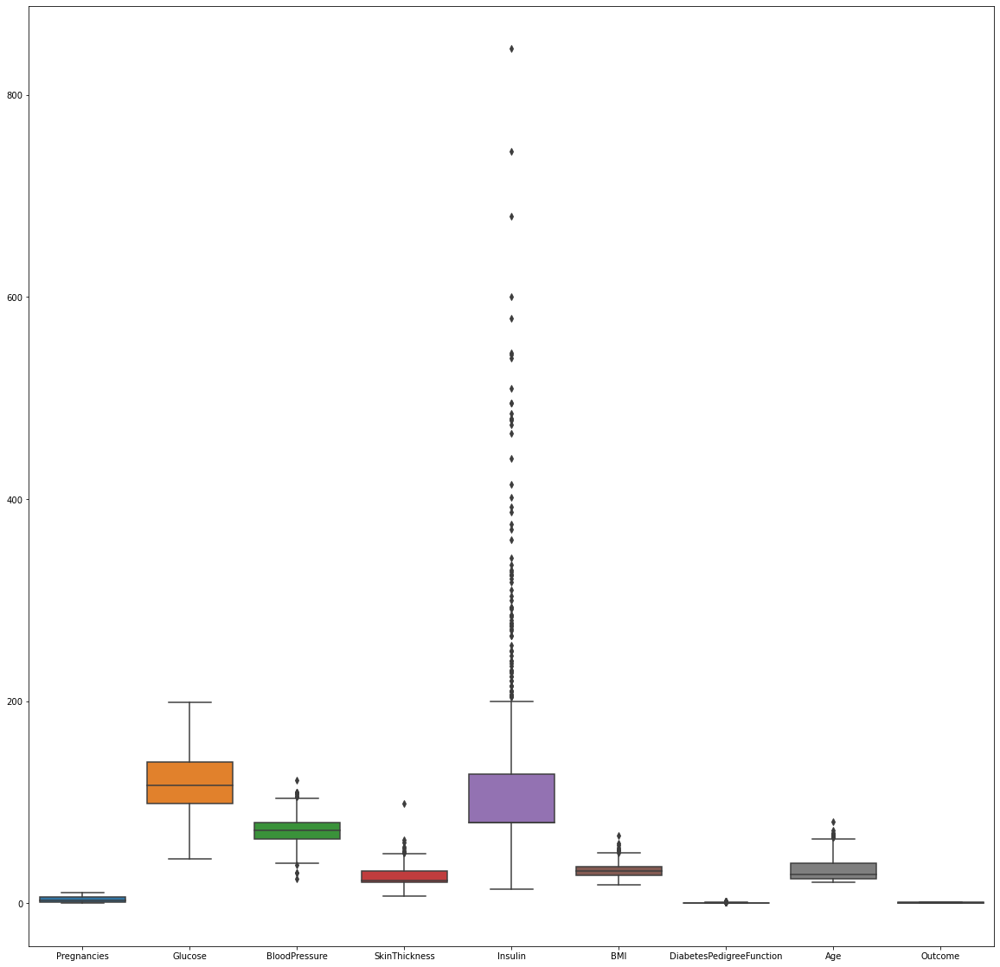

In [27]:
fig,  ax= plt.subplots(figsize = (20,20))  # we remove outlier for Pregnancies column
sns.boxplot(data = df_new, ax = ax)
fig

In [28]:
q = df_new['BMI'].quantile(.98)
df_new = df_new[df_new['BMI'] < q]

In [29]:
df_new

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
4,0,137.0,40.0,35.000000,168.000000,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


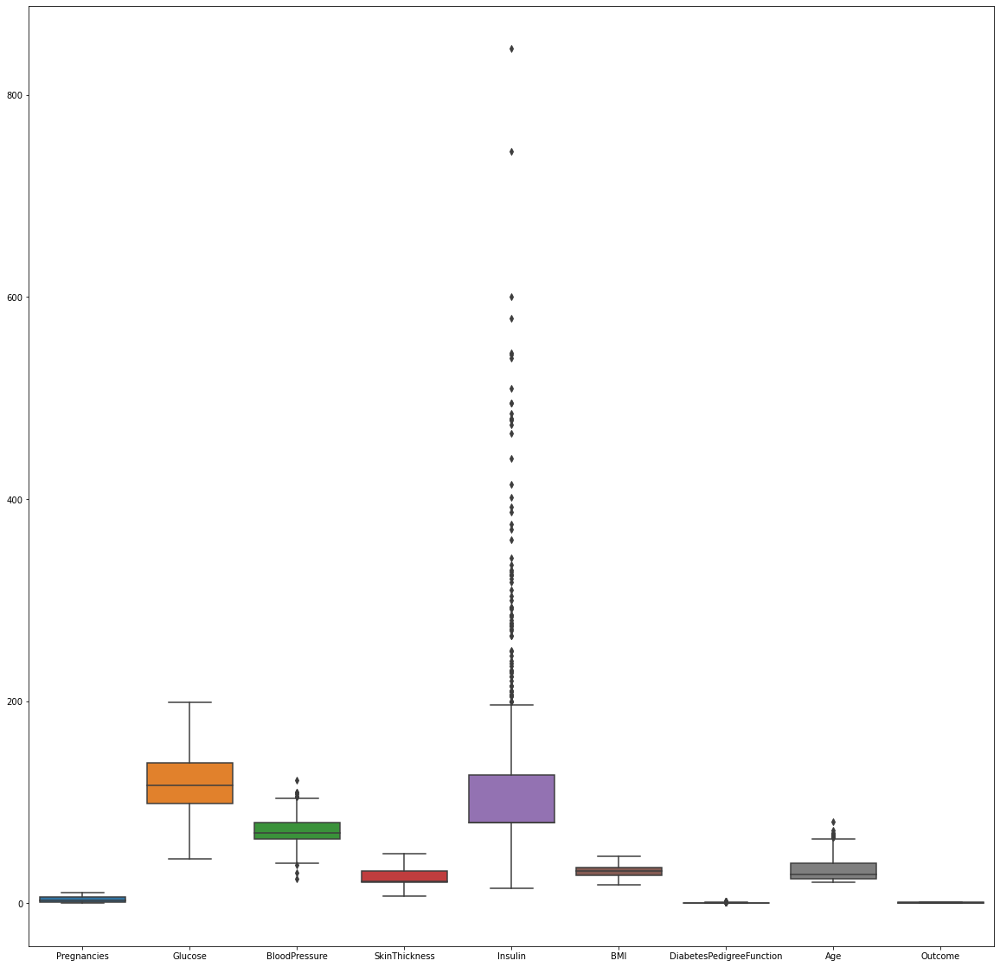

In [32]:
fig,  ax= plt.subplots(figsize = (20,20))  # we remove outlier for Pregnancies column
sns.boxplot(data = df_new, ax = ax)
fig

In [33]:
q = df_new['SkinThickness'].quantile(.99)
df_new = df_new[df_new['SkinThickness'] < q]


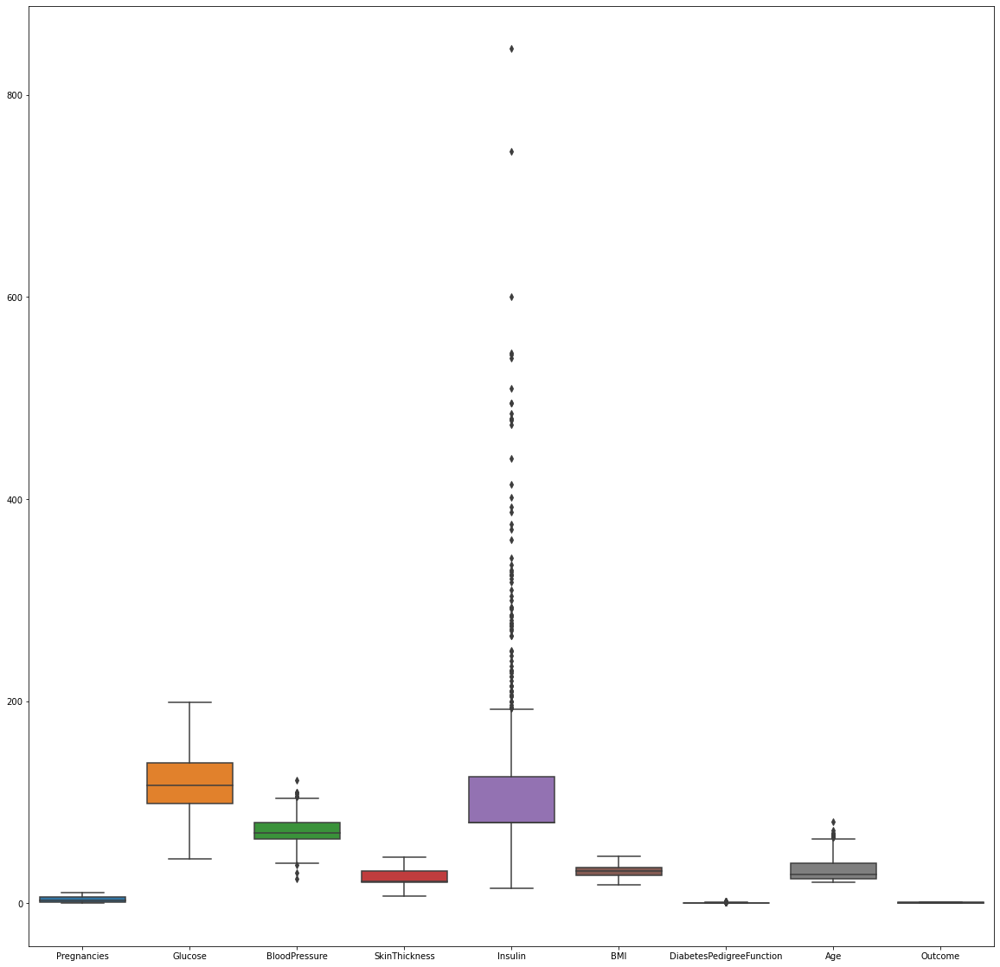

In [34]:
fig,  ax= plt.subplots(figsize = (20,20))  # we remove outlier for Pregnancies column
sns.boxplot(data = df_new, ax = ax)
fig

In [35]:
q = df_new['Insulin'].quantile(.95)
df_new = df_new[df_new['Insulin'] < q]

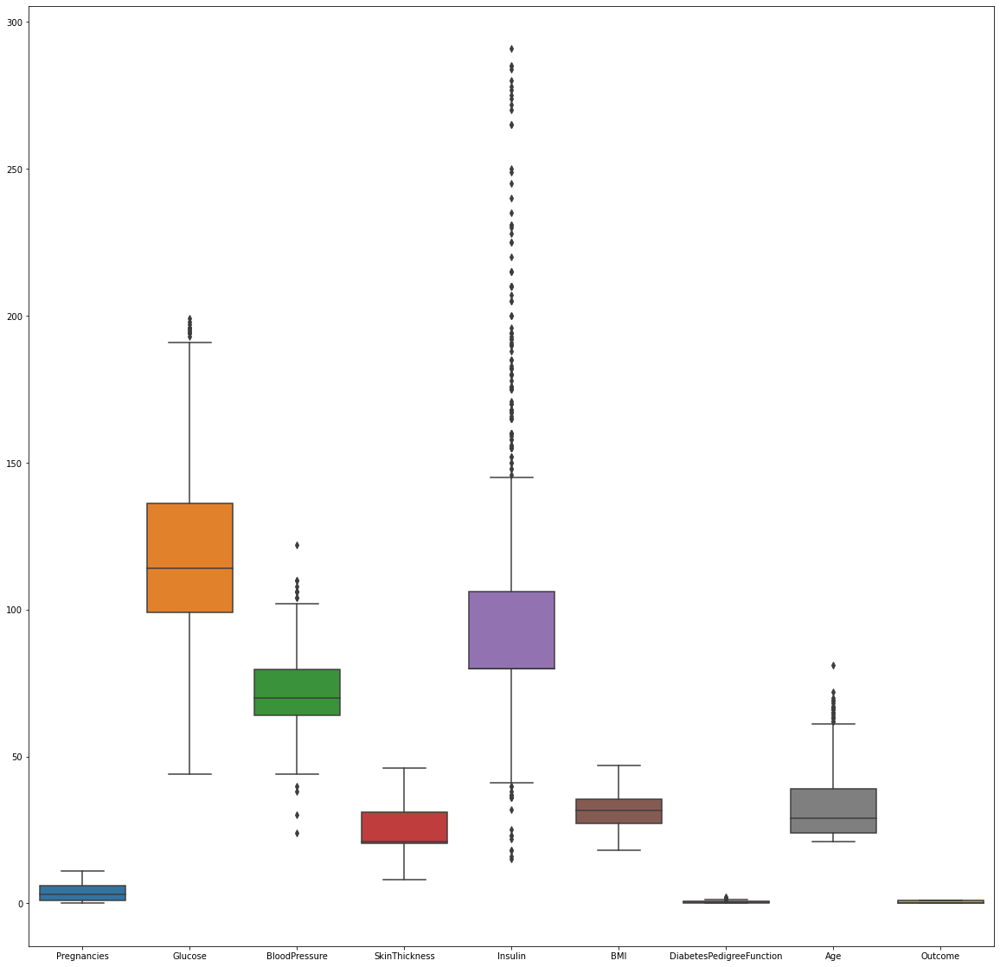

In [36]:
fig,  ax= plt.subplots(figsize = (20,20))  # we remove outlier for Pregnancies column
sns.boxplot(data = df_new, ax = ax)
fig

In [37]:
q = df_new['DiabetesPedigreeFunction'].quantile(.99)
df_new = df[df['DiabetesPedigreeFunction'] < q]

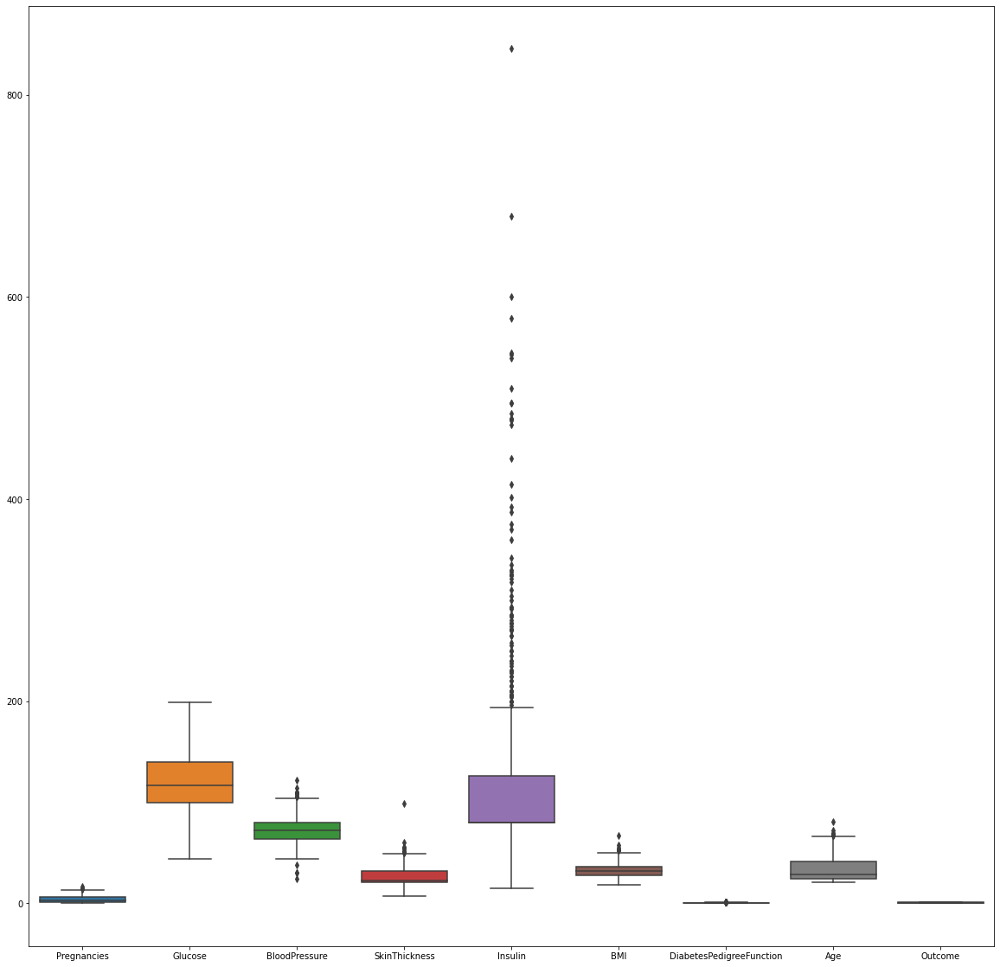

In [38]:
fig,  ax= plt.subplots(figsize = (20,20))  # we remove outlier for Pregnancies column
sns.boxplot(data = df_new, ax = ax)
fig

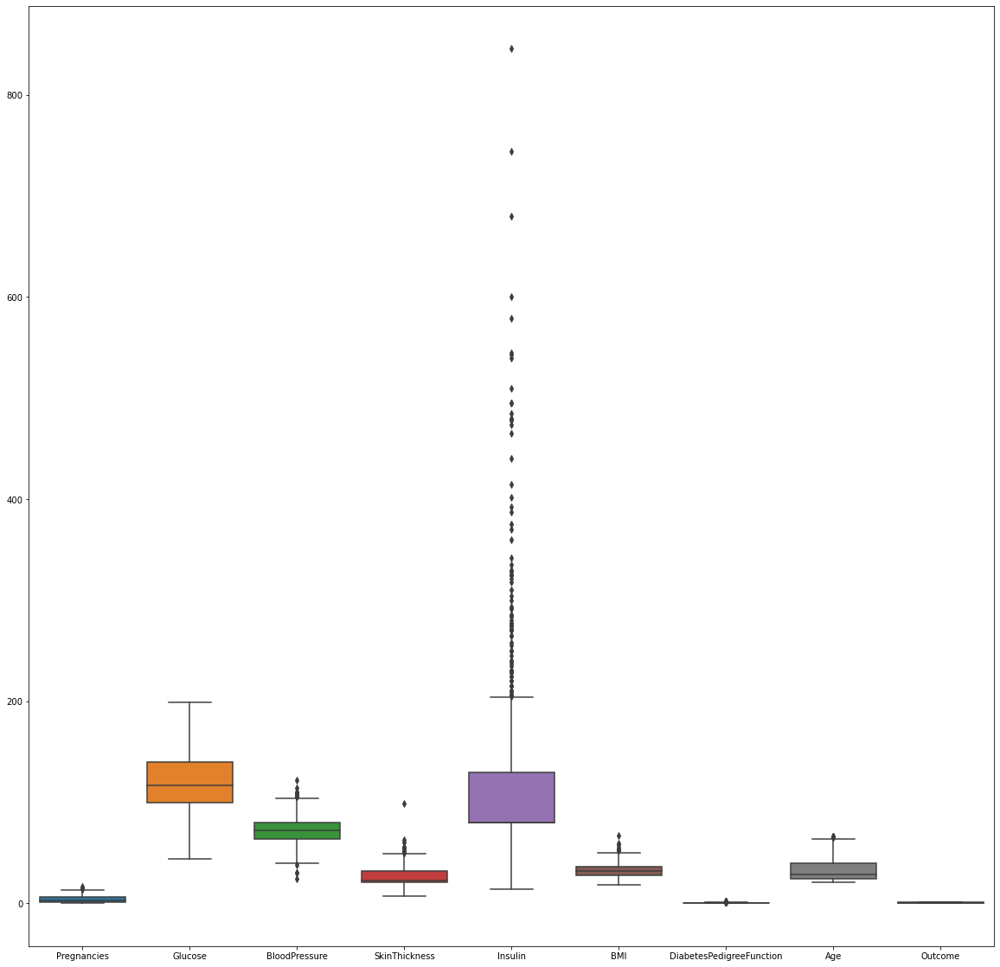

In [39]:
q = df_new['Age'].quantile(.99)
df_new = df[df['Age'] < q]
fig,  ax= plt.subplots(figsize = (20,20))  # we remove outlier for Pregnancies column
sns.boxplot(data = df_new, ax = ax)
fig

In [40]:
df_new

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
4,0,137.0,40.0,35.000000,168.000000,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


In [41]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [42]:
df_new.head()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
4,0,137.0,40.0,35.000000,168.000000,43.1,2.288,33,1


In [43]:
y= df_new['Outcome']

In [44]:
x = df_new.drop(columns=['Outcome'])

In [45]:
x

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21
4,0,137.0,40.0,35.000000,168.000000,43.1,2.288,33
...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47


In [46]:
y

0      1
1      0
2      1
3      0
4      1
      ..
763    0
764    0
765    0
766    1
767    0
Name: Outcome, Length: 759, dtype: int64

In [47]:
scaler = StandardScaler()

In [48]:
ProfileReport(pd.DataFrame(scaler.fit_transform(df_new)))

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

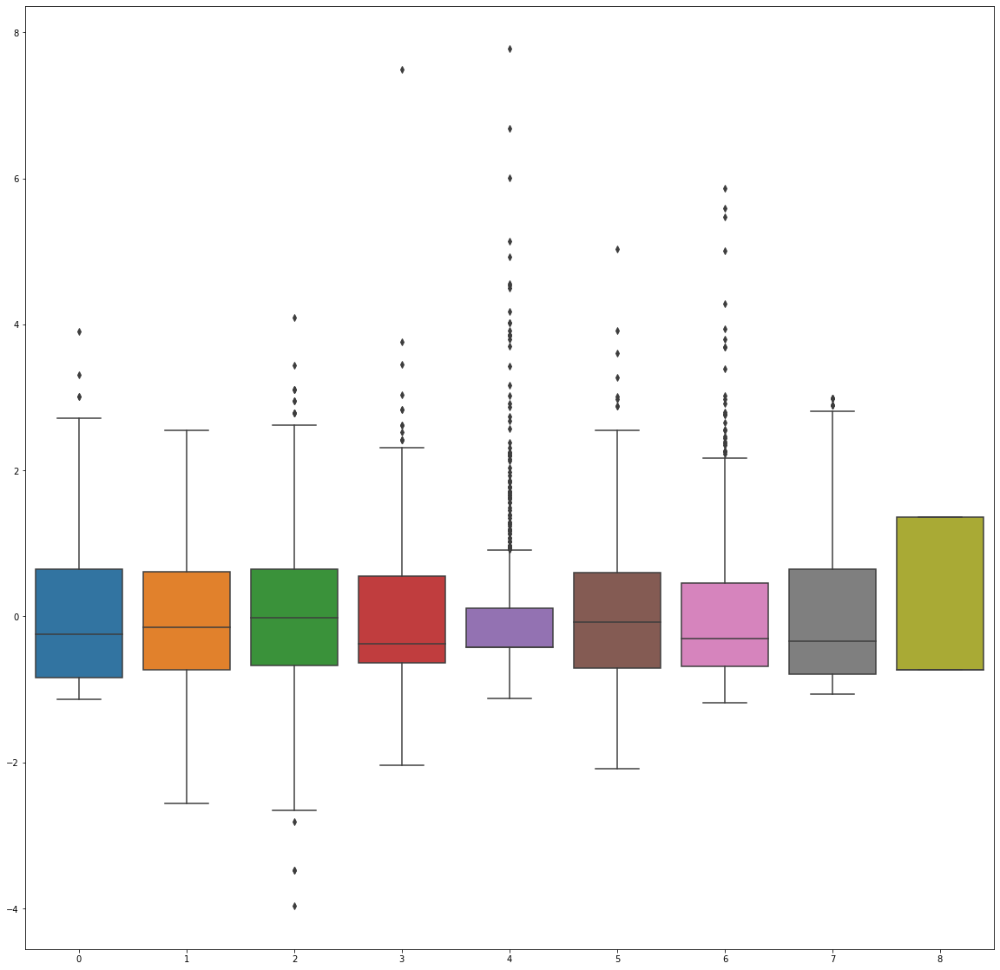

In [51]:
df_new_scalar=pd.DataFrame(scaler.fit_transform(df_new))
fig,  ax= plt.subplots(figsize = (20,20))  # we remove outlier for Pregnancies column
sns.boxplot(data = df_new_scalar, ax = ax)
fig

In [52]:
x_scaled=scaler.fit_transform(x)

In [53]:
x_scaled

array([[ 0.64327075,  0.87008298, -0.01698412, ...,  0.16090077,
         0.46879263,  1.54828125],
       [-0.83984741, -1.20656984, -0.51093456, ..., -0.85816238,
        -0.36177415, -0.16252742],
       [ 1.23651801,  2.02377899, -0.6755847 , ..., -1.33857787,
         0.60421113, -0.07248486],
       ...,
       [ 0.34664712, -0.01991109, -0.01698412, ..., -0.91639456,
        -0.68075995, -0.25256998],
       [-0.83984741,  0.14490263, -1.00488499, ..., -0.3486308 ,
        -0.36779275,  1.27815356],
       [-0.83984741, -0.9428679 , -0.18163427, ..., -0.30495667,
        -0.47010895, -0.88286791]])

In [54]:
def vif_score(x):
    scaler = StandardScaler()
    arr = scaler.fit_transform(x)
    return pd.DataFrame([[x.columns[i], variance_inflation_factor(arr,i)] for i in range(arr.shape[1])], columns=["FEATURE", "VIF_SCORE"])


In [55]:
vif_score(x)

,FEATURE,VIF_SCORE
0,Pregnancies,1.484572
1,Glucose,1.354580
2,BloodPressure,1.247898
3,SkinThickness,1.455095
4,Insulin,1.264776
5,BMI,1.551161
6,DiabetesPedigreeFunction,1.058847
7,Age,1.680199


In [57]:
x_train, x_test,y_train,y_test =train_test_split(x_scaled,y, test_size= .20, random_state = 144)

In [59]:
x_train

array([[-0.54322378, -0.31657578,  1.13556689, ...,  0.85968694,
        -0.67775065, -0.4326551 ],
       [-1.13647104, -0.44842675, -0.34628441, ..., -0.75625607,
         0.95028062, -0.07248486],
       [ 1.82976527,  0.01305165,  0.47696631, ..., -0.71258193,
         0.12272314,  1.09806844],
       ...,
       [ 0.64327075,  0.11193988, -0.34628441, ..., -0.36318885,
        -0.02172326, -0.07248486],
       [-0.83984741, -0.7121287 , -0.01698412, ..., -1.04741697,
         0.56208093, -0.4326551 ],
       [ 0.34664712,  2.22155545, -0.6755847 , ..., -0.18849231,
         0.33638343, -0.34261254]])

In [62]:
logr = LogisticRegression(verbose=1)

In [63]:
logr.fit(x_train, y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s finished


LogisticRegression(verbose=1)

In [71]:
logr.predict_proba([x_test[1]])

array([[0.88820608, 0.11179392]])

In [72]:
logr.predict([x_test[1]])

array([0], dtype=int64)

In [73]:
logr.predict_log_proba([x_test[10]])

array([[-0.2656164 , -1.45557239]])

In [75]:
y_test.iloc[1]

0

In [80]:
logr1 = LogisticRegression(verbose=1, solver='liblinear')

In [81]:
logr1.fit(x_train, y_train)

[LibLinear]

LogisticRegression(solver='liblinear', verbose=1)

In [82]:
y_predict_liblinear= logr1.predict(x_test)
y_predict_liblinear

array([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1,
       0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1,
       0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0],
      dtype=int64)

In [83]:
y_predict_default= logr.predict(x_test)
y_predict_default

array([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1,
       0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1,
       0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0],
      dtype=int64)

In [84]:
# Test with confussion matrix

In [85]:
confusion_matrix(y_test,y_predict_liblinear)

array([[82, 12],
       [26, 32]], dtype=int64)

In [86]:
confusion_matrix(y_test,y_predict_default)

array([[82, 12],
       [26, 32]], dtype=int64)